# Deceptive analysis

In [1]:
from email_utils import *
import pandas as pd
from sklearn.preprocessing import StandardScaler, MaxAbsScaler
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from pipeline_utils import *
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.calibration import CalibratedClassifierCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, f_classif
from joblib import Parallel, delayed
import eli5

rc = {'axes.facecolor':'white',
      'axes.edgecolor': 'white',
      'axes.grid' : True,
      'grid.color': '.7',
      'font.family':'Helvetica',
      'font.size' : 20,
      'xtick.major.width': 0,
      'ytick.major.width': 0,
      'figure.dpi': 300}
plt.rcParams.update(rc)

pd.set_option('display.max_rows', 1500)


2021-09-04 16:39:03 INFO: Writing properties to tmp file: corenlp_server-7bc350ecfb054cf8.props


In [2]:
# Allow unverified HTTPS requests
    #ssl._create_default_https_context = ssl._create_unverified_context

## Read in the emails

In [3]:
emails = pd.read_pickle('../data/release/v1.0/corpus_v1.0.pkl')
emails_ab = pd.read_pickle('../data/release/v1.0/corpus_ab_v1.0.pkl')

In [4]:
emails.columns.values

array(['from_name', 'from_address', 'subject', 'body_text', 'name',
       'office_sought', 'party_affiliation', 'office_level',
       'district_type', 'final_website', 'crawl_date', 'source', 'state',
       'type', 'subtype', 'date', 'hour', 'day', 'uid_email', 'uid_inbox',
       'incumbent'], dtype=object)

In [5]:
emails_ab.columns.values

array(['from_name', 'from_address', 'subject', 'body_text', 'name',
       'office_sought', 'party_affiliation', 'office_level',
       'district_type', 'final_website', 'crawl_date', 'source', 'state',
       'type', 'subtype', 'date', 'hour', 'day', 'uid_email', 'uid_inbox',
       'incumbent', 'location'], dtype=object)

In [6]:
len(emails)

317366

In [7]:
len(emails_ab)

252261

## Analyzing Re: and Fwd: emails

In [8]:
emails['re'] = emails['subject'].str.contains('(?i)(^re:|.* re:)')
emails['fwd'] = emails['subject'].str.contains('(?i)(^fwd:|.* fwd:)')

/var/folders/5g/39xd_xwx0lv588jrnjhg1cmc0000gn/T/ipykernel_3208/2454676668.py:1: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  emails['re'] = emails['subject'].str.contains('(?i)(^re:|.* re:)')
/var/folders/5g/39xd_xwx0lv588jrnjhg1cmc0000gn/T/ipykernel_3208/2454676668.py:2: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  emails['fwd'] = emails['subject'].str.contains('(?i)(^fwd:|.* fwd:)')


What does the breakdown look like?

In [9]:
emails['re'].value_counts()

False    305840
True      11526
Name: re, dtype: int64

In [10]:
emails['fwd'].value_counts()

False    314454
True       2912
Name: fwd, dtype: int64

In [12]:
def check_email_subject(row):
    row_with_re = row[row['re']]
    row_without_re = row[row['re'] == False]
    
    row['deceptive_re_fwd'] = False
    
    row_with_fwd = row[row['fwd']]
    
    if len(row_with_re.index) == 0 and len(row_with_fwd.index) == 0:
        return row
    else:
        result_subject = []
        
        for index, r in row_with_re.iterrows():
            subject = r['subject']
            subject_clean = re.sub('(?i)(^re:|.* re:)', '', subject).strip()
            
            if subject_clean not in row_without_re['subject'].to_list():
                row.loc[index, 'deceptive_re_fwd'] = True
            else:
                continue
                
        for index, r in row_with_fwd.iterrows():
            if 'forwarded message' not in r['body_text'].lower():
                row.loc[index, 'deceptive_re_fwd'] = True
        return row       

emails = emails.groupby(['uid_inbox']).apply(check_email_subject).reset_index(drop=True)

In [13]:
emails['deceptive_re_fwd'].value_counts()

False    306581
True      10785
Name: deceptive_re_fwd, dtype: int64

In [14]:
emails[emails['deceptive_re_fwd']][['name', 'office_sought', 'source', 'subject']]

,name,office_sought,source,subject
16,Kathleen Williams,U.S. House Montana At-large District,ballotpedia-campaign,re: corruption
18,Kathleen Williams,U.S. House Montana At-large District,ballotpedia-campaign,re: we will stand up for Montana’s vulnerable
41,Kathleen Williams,U.S. House Montana At-large District,ballotpedia-campaign,re: numbers update
51,Kathleen Williams,U.S. House Montana At-large District,ballotpedia-campaign,fwd: We’re neck and neck
66,Kathleen Williams,U.S. House Montana At-large District,ballotpedia-campaign,re: Montana’s June 2nd Primary
...,...,...,...,...
316599,Brooke Lunsford,Governor of West Virginia,ballotpedia-campaign,Re: 2020 Campaign
316626,Micah Caskey,South Carolina House of Representatives Distri...,ballotpedia-campaign,Re: Form Submission - Volunteers
317198,Senate Republican Campaign Committee,NaN,orgs,FWD: One Week until Election Day
317287,Daniel Carlino,Montana Public Service Commissioner District 4,ballotpedia-campaign,Fwd: Campaign Announcement for Mayor of Missoula!


Explore the email bodies.

In [15]:
body = emails[emails['subject'] == 'RE: Maddow\'s warning for Democrats'].iloc[0]['body_text']
print('\n'.join(get_email_lines(body)))

we have to fight TWICE as hard and raise TWICE as many resources to win – Rachel Maddow on voter suppression in Georgia – "IT IS A WAKE-UP CALL FOR WHAT IS COMING IN NOVEMBER AND WHAT REPUBLICANS ARE GOING TO TRY TO DO." Team, Rachel Maddow is 100% right: What happened in Georgia's primary election was not an accident – it was the latest example of Republicans trying to buy this election and cling to power. The GOP will do whatever it takes to win – including suppressing our right to vote – and there's simply too much at stake to let them get away with it: Right now polling shows Reverend Raphael Warnock (D) and unelected Sen. Kelly Loeffler (R) NECK AND NECK in Georgia's toss-up race – which The Washington Post says is key to deciding Senate control! With Republicans playing dirty, we have to fight TWICE as hard and raise TWICE as many resources to win. Nate Silver's FiveThirtyEight says Democrats can flip this seat and take back the Senate, but we can't do it without grassroots suppo

Stats by sender:

In [16]:
emails[(emails['name'] == 'Democratic Senatorial Campaign Committee') & (emails['deceptive_re_fwd'] == True)]['subject']

207306          re: President Obama's request for Democrats
207307                  re: Obama's request for Democrats →
207320                          re: vote-by-mail in October
207323                                  re: counting on YOU
207326                        re: voting by mail in October
207327                          re: vote-by-mail this month
207330              re: President Obama's urgent message...
207333                     re: President Obama's message >>
207335                 re: President Obama's urgent message
207336        re: President Barack Obama's must-see message
207337    re: President Obama's message about flipping t...
207340                re: President Obama's message for you
207342             re: President Obama's message for you >>
207345              re: President Obama's important message
207348                        re: TIME's Person of the Year
207349                                  re: paid sick leave
207350                re: Trump's chance

Same for the AB testing emails.

In [17]:
emails_ab['re'] = emails_ab['subject'].str.contains('(?i)(^re:|.* re:)')
emails_ab['fwd'] = emails_ab['subject'].str.contains('(?i)(^fwd:|.* fwd:)')

emails_ab = emails_ab.groupby(['uid_inbox']).apply(check_email_subject).reset_index(drop=True)
emails_ab['deceptive_re_fwd'].value_counts()

/var/folders/5g/39xd_xwx0lv588jrnjhg1cmc0000gn/T/ipykernel_3208/2763525104.py:1: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  emails_ab['re'] = emails_ab['subject'].str.contains('(?i)(^re:|.* re:)')
/var/folders/5g/39xd_xwx0lv588jrnjhg1cmc0000gn/T/ipykernel_3208/2763525104.py:2: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  emails_ab['fwd'] = emails_ab['subject'].str.contains('(?i)(^fwd:|.* fwd:)')


False    236836
True      15425
Name: deceptive_re_fwd, dtype: int64

Write both to disk.

In [18]:
pd.DataFrame({'deceptive_re_fwd_score': emails['deceptive_re_fwd'].to_list()}).to_pickle('../data/output/emails_deceptive_re_fwd_score.pkl')

In [19]:
pd.DataFrame({'deceptive_re_fwd_score': emails_ab['deceptive_re_fwd'].to_list()}).to_pickle('../data/output/emails_ab_deceptive_re_fwd_score.pkl')

## Analyzing From fields that make it seem like an ongoing conversation

In [22]:
def check_email_from(x):
    match1 = re.search('\([0-9]+\)', x.lower())
    match2 = re.search(', me', x.lower())
    match3 = re.search('me, ', x.lower())
    match4 = re.search('email_redacted', x.lower())
    
    if match1 and ',' in x:
        return True
    
    if match2 or match3:
        return True
    
    if match4 and not 'response' in x.lower():
        return True

    return False
    
emails['deceptive_from_thread'] = emails['from_name'].apply(check_email_from)
emails_ab['deceptive_from_thread'] = emails_ab['from_name'].apply(check_email_from)

In [23]:
len(emails[emails['deceptive_from_thread']])

2819

In [24]:
emails[emails['deceptive_from_thread']][['name', 'office_sought', 'source', 'from_name']]

,name,office_sought,source,from_name
120,Kathleen Williams,U.S. House Montana At-large District,ballotpedia-campaign,"Kathleen Williams, me (2)"
144,Kathleen Williams,U.S. House Montana At-large District,ballotpedia-campaign,"Blake Thompson, me (2)"
3821,Tedra Cobb,U.S. House New York District 21,ballotpedia-campaign,"Tedra, me (2)"
4563,Josh Owens,Governor of Indiana,ballotpedia-campaign,"Christina, you (2)"
4609,Josh Owens,Governor of Indiana,ballotpedia-campaign,"Christina, Alex (2)"
...,...,...,...,...
314781,Yvette D. Clarke,U.S. House New York District 9,ballotpedia-campaign,"Tim, me (1)"
314826,Yvette D. Clarke,U.S. House New York District 9,ballotpedia-campaign,"me, Tim P. (1)"
316167,Carlos Gimenez,U.S. House Florida District 26,ballotpedia-campaign,"Celia, me (2)"
316309,Sharice Davids,U.S. House Kansas District 3,ballotpedia-campaign,Unread message for email_redacted


In [25]:
pd.DataFrame({'deceptive_from_thread_score': emails['deceptive_from_thread'].to_list()}).to_pickle('../data/output/emails_deceptive_from_thread_score.pkl')

In [26]:
pd.DataFrame({'deceptive_from_thread_score': emails_ab['deceptive_from_thread'].to_list()}).to_pickle('../data/output/emails_ab_deceptive_from_thread_score.pkl')

In [27]:
emails = None

## Analyzing From fields that obscure/hide the name of the sender

Read in the labeled dataset.

In [28]:
df = pd.read_pickle('../data/learning/coded_df.pkl')
df_labels = pd.read_pickle('../data/learning/coded_labels.pkl')
label_column = 'obscured_name'

df = pd.concat([df, df_labels[label_column].reset_index(drop=True)], axis=1)

In [29]:
df[label_column].value_counts()

False    1668
True     1006
Name: obscured_name, dtype: int64

In [30]:
df.columns

Index(['name', 'subject', 'subject_decoded', 'from_name', 'from_address',
       'from_name_decoded', 'party_affiliation', 'source', 'office_level',
       'incumbent', 'input', 'input_decoded', 'input_decoded_ngram',
       'from_name_decoded_entities_replaced_lowercase',
       'from_name_decoded_entities_preserved_lowercase',
       'subject_decoded_entities_replaced_lowercase',
       'subject_decoded_entities_preserved_lowercase',
       'from_name_decoded_ngram_tags',
       'from_name_decoded_ngram_tags_stopwords', 'subject_decoded_ngram_tags',
       'subject_decoded_ngram_tags_stopwords', 'input_decoded_ngram_tags',
       'input_decoded_ngram_tags_stopwords',
       'from_name_decoded_ngram_tags_original',
       'from_name_decoded_ngram_tags_stopwords_original',
       'subject_decoded_ngram_tags_original',
       'subject_decoded_ngram_tags_stopwords_original',
       'input_decoded_ngram_tags_original',
       'input_decoded_ngram_tags_stopwords_original',
       'from_nam

In [31]:
len(df)

2674

### Split the data

Split the data into train and test sets.

In [32]:
labels = df[label_column]

In [33]:
xTrain, xVal, yTrain, yVal = train_test_split(df, labels, test_size=0.20, stratify=labels, random_state=random_state)

In [34]:
len(xTrain), len(yTrain)

(2139, 2139)

In [35]:
len(xVal), len(yVal)

(535, 535)

### Features

Feature pipeline:

In [36]:
def get_feature_pipeline():
    return Pipeline([('features', FeatureUnion([
        ('counts', Pipeline([
            ('features', DataSelector(column_list=['from_name_unicode_count',
                                                   'from_name_raw_length',
                                                   'from_name_decoded_word_count'])),
            ('scale', MaxAbsScaler()),
        ])),
        ('match', Pipeline([
            ('features', DataSelector(column_list=['leading_match',
                                                   'match_proportion']))
        ])),
        ('decoded_prop', Pipeline([
            ('features', DataSelector(column_list=['from_name_decoded_stop_words_prop',
                                                   'from_name_decoded_digits_prop',
                                                   'from_name_decoded_upper_prop',
                                                   'from_name_decoded_lower_prop',]))
        ])),
        ('ngram_tags', Pipeline([
                ('column_selector', ColumnSelector(column='from_name_decoded_ngram_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('pos_tags', Pipeline([
                ('column_selector', ColumnSelector(column='from_name_decoded_pos_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('dep_tags', Pipeline([
                ('column_selector', ColumnSelector(column='from_name_decoded_dep_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ]))
    ])),
                     ('scale', MaxAbsScaler()),
                     ('select', SelectKBest(f_classif))])

def get_feature_names(classifier):
    features = []
    for transformer in classifier.named_steps['feature_pipeline'].named_steps['features'].transformer_list:
        features.extend(transformer[1].named_steps['features'].get_feature_names())

    return features

### Support Vector Classifier

Grid search using 5-fold cross validation 

In [37]:
param_grid = {'classifier__C': [0.01, 0.1, 1.0, 10, 100],
              'classifier__kernel': ['rbf', 'linear'],
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__pos_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__dep_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}
          
svc_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                     ('classifier', svm.SVC(class_weight='balanced', probability=True, random_state=random_state))])

svc_clf = RandomizedSearchCV(svc_pipe, param_grid, n_jobs=-1, cv=5, n_iter=2000, verbose=5, scoring='f1', random_state=random_state)

svc_results = nested_cross_validation(svc_clf, xTrain, yTrain)

Fitting 5 folds for each of 2000 candidates, totalling 10000 fits


2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-3ba4d9d3d2df4c63.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-03330c1625c243da.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-bd16a283c0884629.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-a25f8b2e363d4149.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-5dda225c07ee41e8.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-1b6ba92500d94a39.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-ad5428dc0d9945eb.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-8109b4a7375b472b.props
2021-08-23 20:37:27 INFO: Writing properties to tmp file: corenlp_server-739b700bc5a040aa.props
2021-08-23 20:37:28 INFO: Writing properties to tmp file: corenlp_server-7adad42de5f74d4e.props
2021-08-23 20:37:28 INFO: Writing proper

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.804 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   1.0s[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   0.6s[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.807 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.9s[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   1.2s[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.919 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.4s[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.926 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_t

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.907 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.889 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.923 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.935 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.930 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipel

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.907 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.907 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.923 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.920 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.938 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.929 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.931 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.917 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.925 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.930 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.909 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeli

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.914 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.919 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.926 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__de

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.923 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.917 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipel

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipel

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.931 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.930 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__d

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.920 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.793 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.916 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.932 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.804 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.916 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.5sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 4/5] END

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.923 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.925 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.935 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.930 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.925 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.933 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipelin

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.933 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.929 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.933 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.799 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.904 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.894 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipelin

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.932 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.925 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.927 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.796 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.919 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.799 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.927 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.905 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.900 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipel

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.937 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.940 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.925 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.804 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.928 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.801 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeli

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.926 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.925 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.796 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.796 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.920 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.920 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.926 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.929 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.936 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.931 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.925 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.919 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.905 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.925 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.934 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.917 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.908 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.919 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.925 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.926 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.933 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.929 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.926 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.929 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.3sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 4/5] END

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.801 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.883 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.912 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.924 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.909 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.897 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.804 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.886 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeli

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipe

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipel

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.895 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.919 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.921 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pip

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.930 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.919 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.914 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.926 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.929 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.911 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.899 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.923 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.928 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.925 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.916 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.929 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.924 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.914 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.925 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.924 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeli

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.920 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 4/5] END 

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.804 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.920 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.796 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.900 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.911 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.913 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.930 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_t

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.931 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.923 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.678 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.895 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.934 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.930 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.919 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.900 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.914 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.921 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.904 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.903 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.807 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.807 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.908 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.946 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.913 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.925 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.938 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.909 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.938 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.930 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.919 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.834 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.894 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.909 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.929 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.917 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.919 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.904 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 2/5] END c

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.924 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.930 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.916 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.804 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pip

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.931 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.919 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.901 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.908 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pi

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.929 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.903 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.804 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.925 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.804 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipel

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.927 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.923 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.834 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.922 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.917 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.927 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.801 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.909 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.904 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipe

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.917 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.934 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.922 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.916 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.923 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.930 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.799 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.901 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.799 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.904 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.921 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.912 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.907 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.802 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.911 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.908 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.914 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pip

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.799 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.920 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

In [38]:
for i, sr in enumerate(svc_results):
    print('Fold ', i)
    print('F1 score ', sr[0])
    print('Params ', sr[2])
    print('\n')

Fold  0
F1 score  0.8932038834951457
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 1.0, 'feature_pipeline__features__ngram_tags__features__max_df': 1.0, 'feature_pipeline__features__dep_tags__features__max_df': 0.04, 'classifier__kernel': 'rbf', 'classifier__C': 10}


Fold  1
F1 score  0.9090909090909092
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 1.0, 'feature_pipeline__features__ngram_tags__features__max_df': 0.04, 'feature_pipeline__features__dep_tags__features__max_df': 0.02, 'classifier__kernel': 'rbf', 'classifier__C': 1.0}


Fold  2
F1 score  0.8994082840236686
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 1.0, 'feature_pipeline__features__ngram_tags__features__max_df': 1.0, 'feature_pipeline__features__dep_tags__features__max_df': 0.01, 'classifier__kernel': 'rbf', 'classifier__C': 10}


Fold  3
F1 score  0.

In [39]:
np.mean(list(map(lambda x: x[0], svc_results)))

0.9008322019315358

In [40]:
features_all = get_feature_names(svc_results[1][1])
features_mask = svc_results[1][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_svc = [b for a, b in zip(features_mask, features_all) if a]

In [41]:
eli5.explain_weights(svc_results[1][1].named_steps['classifier'], top=100, feature_names=features_svc)

Explanation(estimator="SVC(class_weight='balanced', probability=True, random_state=2020)", description=None, error="only kernel='linear' is currently supported for libsvm-based classifiers", method=None, is_regression=False, targets=None, feature_importances=None, decision_tree=None, highlight_spaces=None, transition_features=None, image=None)

### Random Forest Classifier

Randomized search using 5-fold cross validation

In [42]:
n_estimators = [10, 50, 100, 200, 500]
max_depth = [10, 30, 50, 100]
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [2, 5, 10]
criterion = ['gini', 'entropy']

param_grid = {'classifier__n_estimators': n_estimators,
              'classifier__max_depth': max_depth,
              'classifier__min_samples_split': min_samples_split,
              'classifier__min_samples_leaf': min_samples_leaf,
              'classifier__criterion': criterion,
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__pos_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__dep_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}

rf_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                    ('classifier', RandomForestClassifier(class_weight='balanced', random_state=random_state))])

rf_clf = RandomizedSearchCV(rf_pipe, param_grid, n_jobs=-1, cv=5, n_iter=2000, verbose=5, scoring='f1', random_state=random_state)
rf_results = nested_cross_validation(rf_clf, xTrain, yTrain)

Fitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.6s
[CV 3/5] E

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.907 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, scor

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, s

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, sco

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, scor

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, s

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.8

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.894 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.804 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, 

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.920 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.801 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.804 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipelin

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, 

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.798 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.910 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.916 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200,

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.804 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.896 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, 

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.896 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, 

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.895 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.917 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.903 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__f

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.896 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.909 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.898 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.916 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, f

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   1.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.902 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.895 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.882 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.914 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500,

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10,

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.888 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.804 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.910 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100,

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.903 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.908 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.924 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.887 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.804 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.901 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, 

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.895 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.901 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.906 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.901 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   2.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.801 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   2.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.799 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=2

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.790 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   1.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.879 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.903 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.902 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.897 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200,

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   2.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.909 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.907 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.888 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.903 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.901 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.904 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.900 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.926 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.886 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.872 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.888 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.893 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifie

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.858 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.802 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.890 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.896 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500,

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.916 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500,

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.903 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.896 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.908 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.804 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.891 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.850 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.911 total time=   1.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, 

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.910 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.919 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, f

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50,

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   1.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.894 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.869 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.917 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.898 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   1.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.804 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.914 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.890 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.894 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.869 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.907 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.695 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   1.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.892 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.911 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10,

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   1.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.912 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.901 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.914 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.905 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.894 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, class

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.904 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.923 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.901 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.880 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.897 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.801 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500,

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500,

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.892 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.850 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.871 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.872 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.872 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.868 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.906 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.884 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.908 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.907 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, f

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.869 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100,

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.897 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.880 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.861 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.864 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.890 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.854 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=5

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.873 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.922 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.886 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, 

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.804 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100,

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.887 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.884 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.793 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.802 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.897 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.876 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.893 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   0.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.867 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100,

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.888 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, 

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.910 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, f

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.893 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.887 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.878 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.883 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.890 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.895 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.883 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.888 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.900 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.796 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.664 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.882 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.880 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.881 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.876 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.904 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.864 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.902 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.884 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.856 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.880 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.854 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.890 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.893 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.858 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.913 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.904 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.874 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.894 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.879 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, f

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.872 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.869 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.891 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.913 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.905 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.868 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.898 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.674 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.855 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.807 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.909 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.883 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.872 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.856 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.898 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, f

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.892 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.840 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.876 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.891 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.879 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.858 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.888 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.864 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.891 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.799 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.854 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.834 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.864 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.802 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.883 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.891 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.874 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.894 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.918 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.913 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.906 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.907 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.902 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.860 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.883 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.845 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.865 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.920 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.883 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.873 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.878 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.919 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.880 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.860 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.880 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.860 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.918 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.890 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.895 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.902 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.878 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.891 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.895 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.874 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.887 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.893 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.884 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.863 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.856 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.896 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.898 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.901 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.890 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.896 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.878 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.843 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.905 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.869 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.834 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.863 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.910 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.893 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.921 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.913 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.900 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.854 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.913 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.887 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.874 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.913 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.668 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.878 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.858 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.860 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.846 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe


[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.873 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fe


[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe


[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, fea


[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature


[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.899 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu


[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.856 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature


[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.885 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel


[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, 


[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.871 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe


[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip


[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature


[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe


[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10

In [40]:
for i, rr in enumerate(rf_results):
    print('Fold ', i)
    print('F1 score ', rr[0])
    print('Params ', rr[2])
    print('\n')

Fold  0
F1 score  0.896551724137931
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags__features__max_df': 1.0, 'feature_pipeline__features__dep_tags__features__max_df': 0.1, 'classifier__n_estimators': 200, 'classifier__min_samples_split': 2, 'classifier__min_samples_leaf': 2, 'classifier__max_depth': 100, 'classifier__criterion': 'entropy'}


Fold  1
F1 score  0.9341692789968652
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 1.0, 'feature_pipeline__features__ngram_tags__features__max_df': 1.0, 'feature_pipeline__features__dep_tags__features__max_df': 0.02, 'classifier__n_estimators': 200, 'classifier__min_samples_split': 2, 'classifier__min_samples_leaf': 2, 'classifier__max_depth': None, 'classifier__criterion': 'gini'}


Fold  2
F1 score  0.893258426966292
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__po

In [41]:
np.mean(list(map(lambda x: x[0], rf_results)))

0.9037189920092598

In [42]:
features_all = get_feature_names(rf_results[1][1])
features_mask = rf_results[1][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_rf = [b for a, b in zip(features_mask, features_all) if a]

In [43]:
eli5.explain_weights(rf_results[1][1].named_steps['classifier'], top=100, feature_names=features_rf)

Weight,Feature
0.0940 ± 0.2749,PROPN
0.0733 ± 0.2281,tokenperson
0.0671 ± 0.1953,from_name_raw_length
0.0629 ± 0.1571,match_proportion
0.0621 ± 0.2196,PROPN PROPN
0.0548 ± 0.1623,VERB
0.0539 ± 0.1427,leading_match
0.0535 ± 0.1423,from_name_decoded_upper_prop
0.0475 ± 0.1586,from_name_decoded_lower_prop
0.0390 ± 0.1329,NOUN


### Compute the final performance on the holdout set

In [43]:
rf_results[1][2]

{'feature_pipeline__select__k': 500,
 'feature_pipeline__features__pos_tags__features__max_df': 1.0,
 'feature_pipeline__features__ngram_tags__features__max_df': 1.0,
 'feature_pipeline__features__dep_tags__features__max_df': 0.1,
 'classifier__n_estimators': 200,
 'classifier__min_samples_split': 5,
 'classifier__min_samples_leaf': 2,
 'classifier__max_depth': 30,
 'classifier__criterion': 'entropy'}

In [44]:
clf = Pipeline([('feature_pipeline', get_feature_pipeline()),
                ('classifier', RandomForestClassifier(class_weight='balanced', random_state=random_state))])

clf.set_params(**rf_results[1][2])
clf.fit(xTrain, yTrain)

Pipeline(steps=[('feature_pipeline',
                 Pipeline(steps=[('features',
                                  FeatureUnion(transformer_list=[('counts',
                                                                  Pipeline(steps=[('features',
                                                                                   DataSelector(column_list=['from_name_unicode_count',
                                                                                                             'from_name_raw_length',
                                                                                                             'from_name_decoded_word_count'])),
                                                                                  ('scale',
                                                                                   MaxAbsScaler())])),
                                                                 ('match',
                                                               

In [45]:
holdout = pd.read_pickle('../data/learning/holdout_df.pkl')
holdout_labels  = pd.read_pickle('../data/learning/holdout_labels.pkl')

holdout = pd.concat([holdout, holdout_labels[label_column].reset_index(drop=True)], axis=1)

Test set output:
1. Classification report:
              precision    recall  f1-score   support

       False       0.97      0.95      0.96       307
        True       0.92      0.95      0.94       193

    accuracy                           0.95       500
   macro avg       0.95      0.95      0.95       500
weighted avg       0.95      0.95      0.95       500



2. Confusion matrix:
     pred_neg  pred_pos
neg       291        16
pos         9       184


4. False positives:
                                          name  \
62                               Tea Party PAC   
99                               Valerie Plame   
135                                 Tom Winter   
164                          Chrysta Castaneda   
213                                Dick Durbin   
305                   Voter Protection Project   
330                            Ruben Rodriguez   
334                                 Jason Crow   
339                       Xochitl Torres Small   
353  Democrat

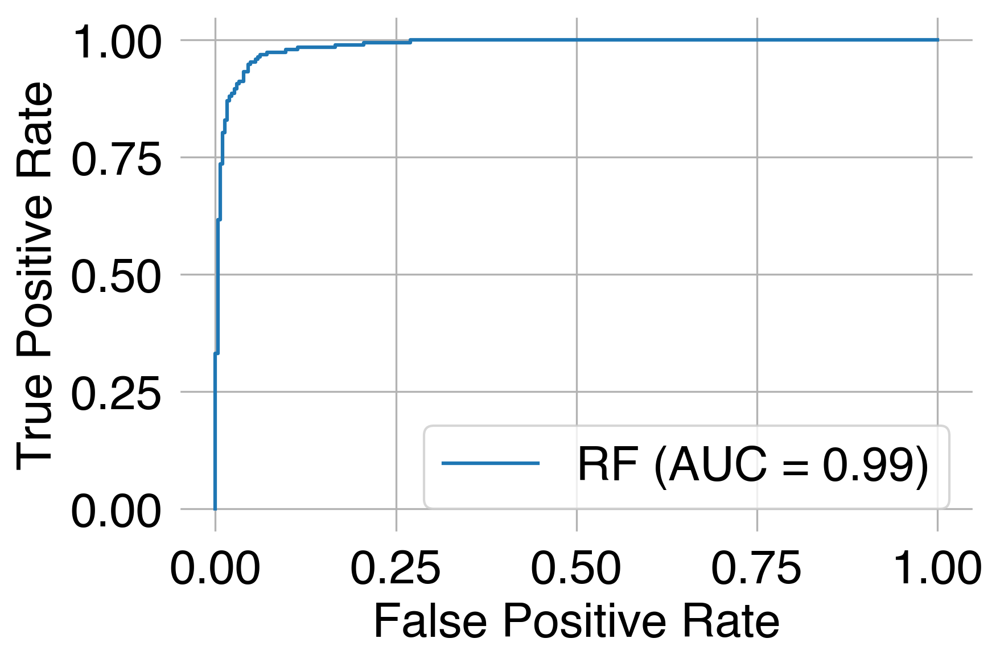

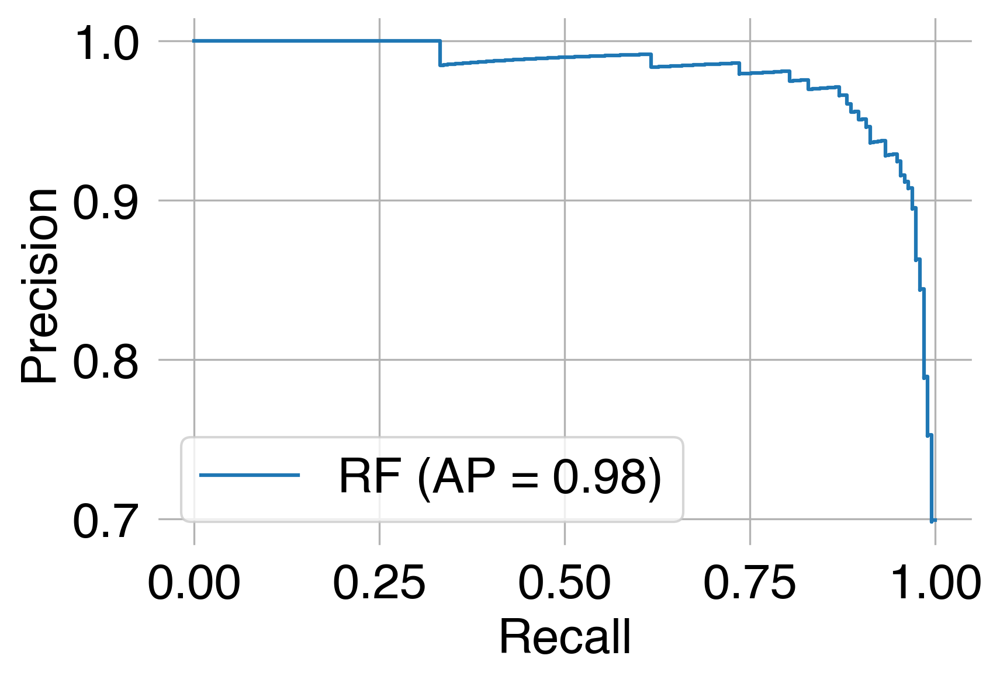

In [63]:
print_classifier_output(clf, holdout, holdout[label_column], actual_subjects=holdout, classifier_name='RF', filepath='../data/plots/obscured_name_')

### Calibration test

  category      prop      mean        ll        ul  count
0        1  0.009772  0.095290  0.006443  0.018560  307.0
1        2  0.509804  0.514097  0.132995  0.131621   51.0
2        3  0.971751  0.882684  0.036165  0.016123  177.0


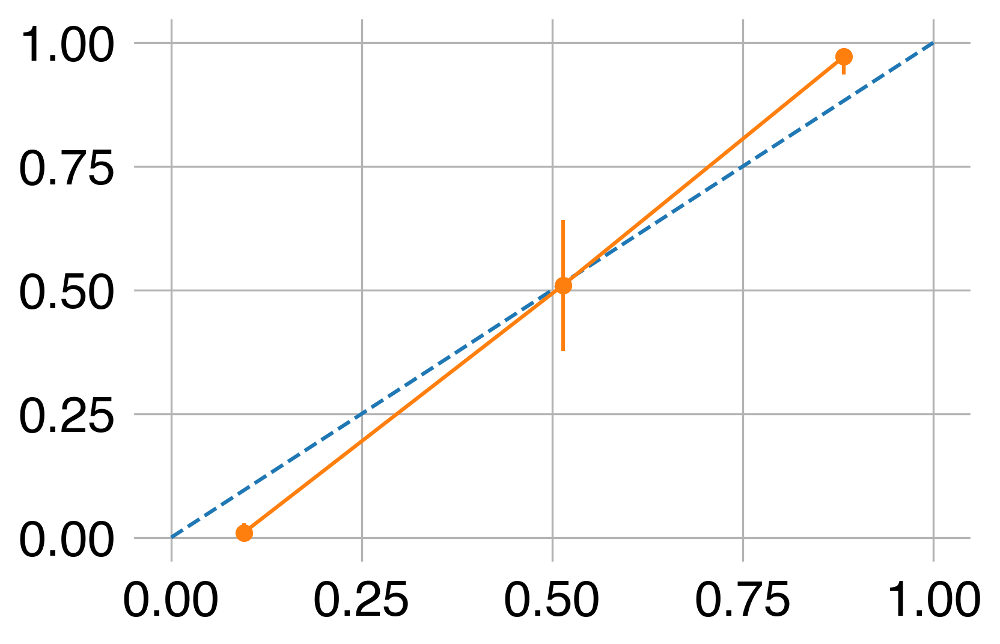

  category                 group      prop      mean        ll        ul  \
0        1  ballotpedia-campaign  0.004386  0.083061  0.003611  0.020035   
1        1                  orgs  0.025316  0.130583  0.018346  0.062369   
2        2  ballotpedia-campaign  0.607143  0.512361  0.183052  0.157200   
3        2                  orgs  0.391304  0.516210  0.169728  0.200840   
4        3  ballotpedia-campaign  0.988506  0.878720  0.050778  0.009462   
5        3                  orgs  0.955556  0.886517  0.064324  0.027027   

   count  
0  228.0  
1   79.0  
2   28.0  
3   23.0  
4   87.0  
5   90.0  
Brier score loss: 0.043987370658557394


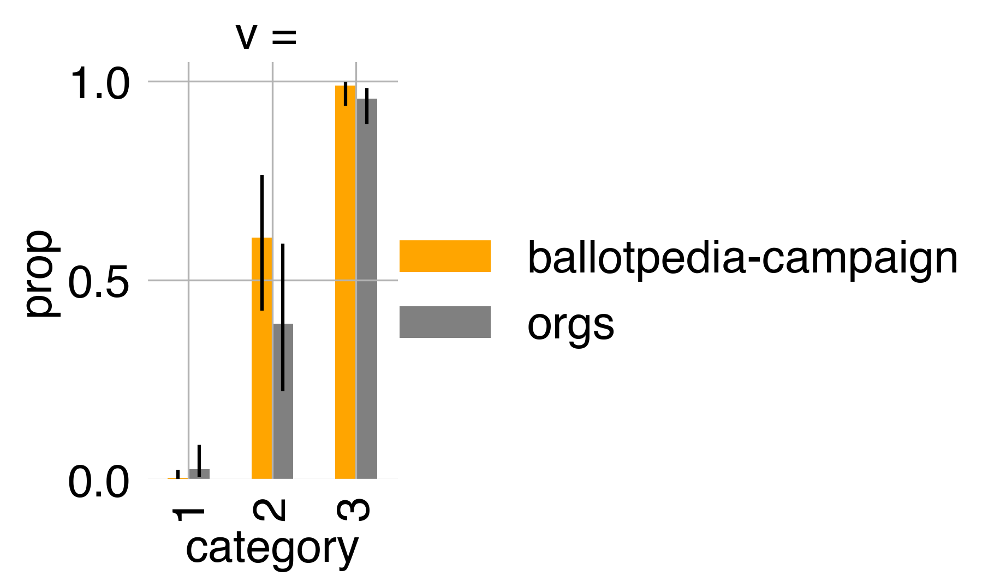

In [47]:
print_calibration_output(clf, xVal, yVal, groups=xVal['source'], bins=3)

In [48]:
featVal = clf.named_steps['feature_pipeline'].transform(xVal).todense()

c = CalibratedClassifierCV(base_estimator=clf.named_steps['classifier'],
                           cv='prefit', method='sigmoid')

c.fit(featVal, yVal)

CalibratedClassifierCV(base_estimator=RandomForestClassifier(class_weight='balanced',
                                                             criterion='entropy',
                                                             max_depth=30,
                                                             min_samples_leaf=2,
                                                             min_samples_split=5,
                                                             n_estimators=200,
                                                             random_state=2020),
                       cv='prefit')

  category      prop      mean        ll        ul  count
0        1  0.015337  0.025948  0.008769  0.020058  326.0
1        2  0.600000  0.490659  0.242532  0.201755   15.0
2        3  0.963918  0.954562  0.036512  0.018496  194.0


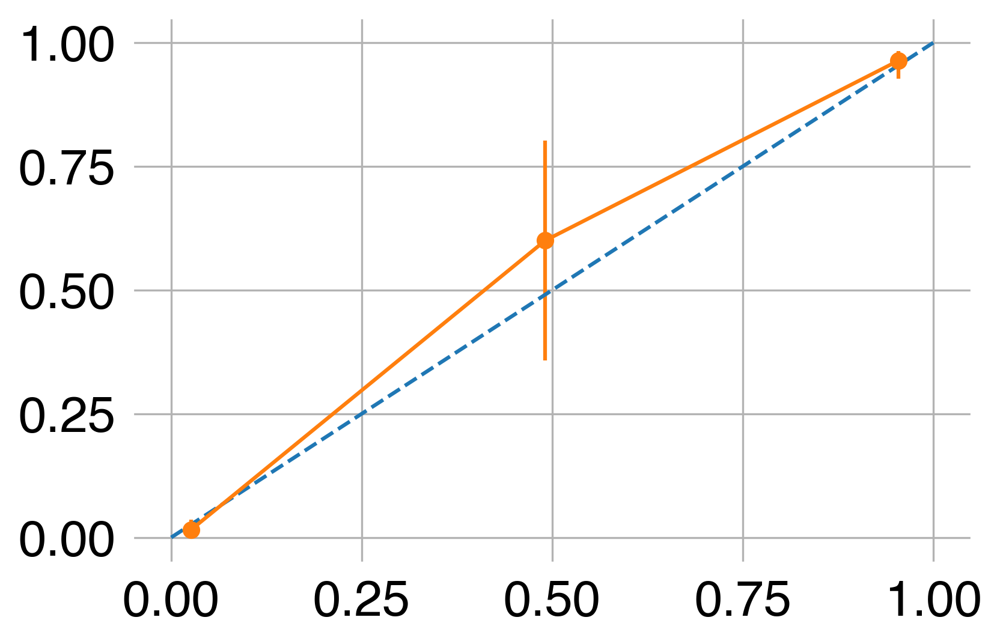

  category                 group      prop      mean        ll        ul  \
0        1  ballotpedia-campaign  0.012552  0.020890  0.008274  0.023696   
1        1                  orgs  0.022989  0.039842  0.016661  0.057005   
2        2  ballotpedia-campaign  0.833333  0.454326  0.396836  0.136613   
3        2                  orgs  0.444444  0.514881  0.255666  0.288904   
4        3  ballotpedia-campaign  0.979592  0.946862  0.050974  0.014794   
5        3                  orgs  0.947917  0.962422  0.064101  0.029634   

   count  
0  239.0  
1   87.0  
2    6.0  
3    9.0  
4   98.0  
5   96.0  
Brier score loss: 0.029649109540056548


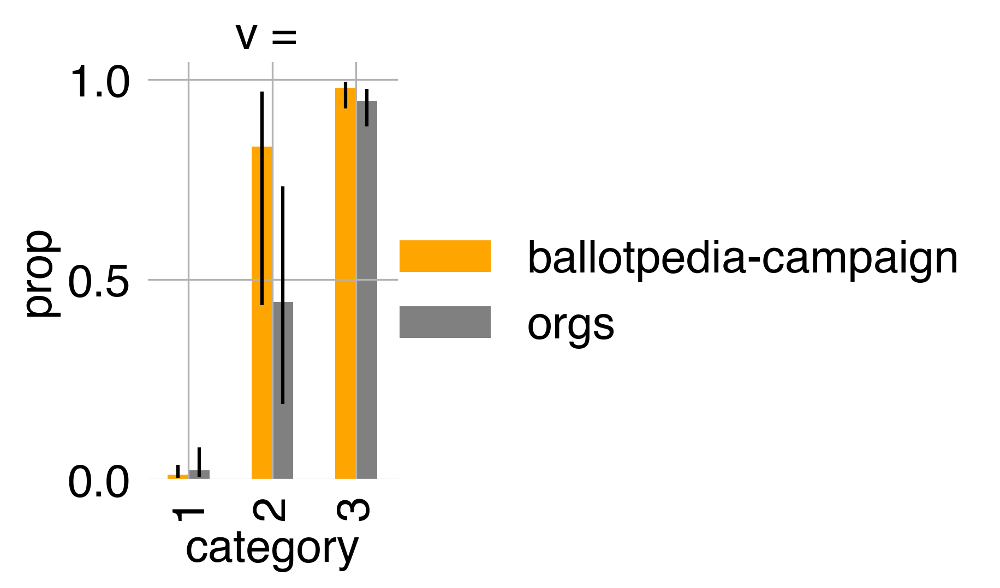

In [49]:
print_calibration_output(c, featVal, yVal, groups=xVal['source'], bins=3)

  category      prop      mean        ll        ul  count
0        1  0.027344  0.031492  0.014037  0.028012  256.0
1        2  0.963303  0.941291  0.053880  0.022336  109.0


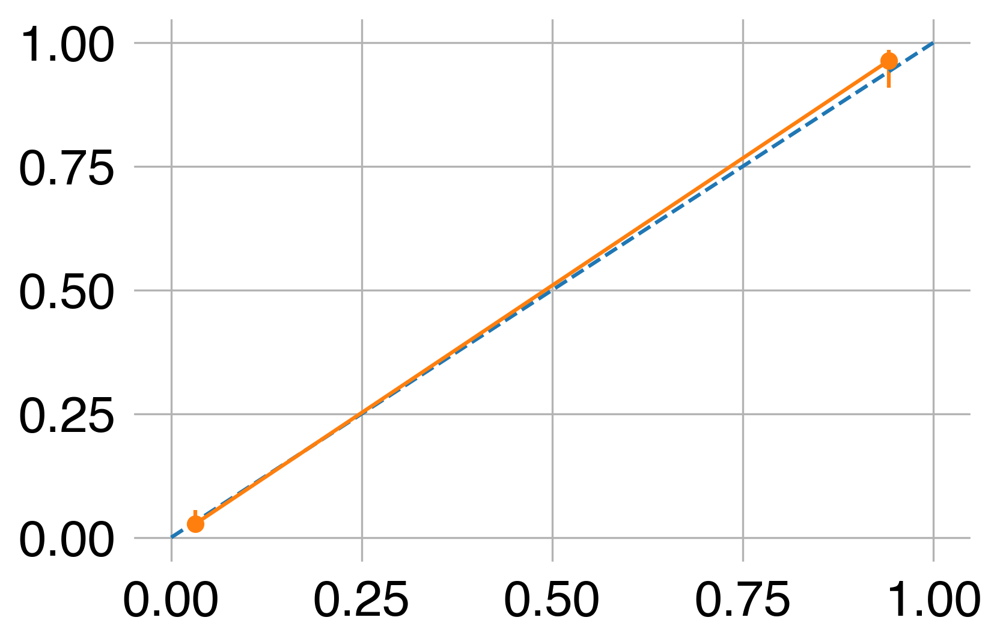

  category             group      prop      mean            ll        ul  \
0        1  Democratic Party  0.035000  0.030745  1.794446e-02  0.035471   
1        1  Republican Party  0.000000  0.034160 -6.938894e-18  0.064194   
2        2  Democratic Party  0.960396  0.942725  5.783523e-02  0.024097   
3        2  Republican Party  1.000000  0.923189  3.244076e-01  0.000000   

   count  
0  200.0  
1   56.0  
2  101.0  
3    8.0  
Brier score loss: 0.022659642983885894


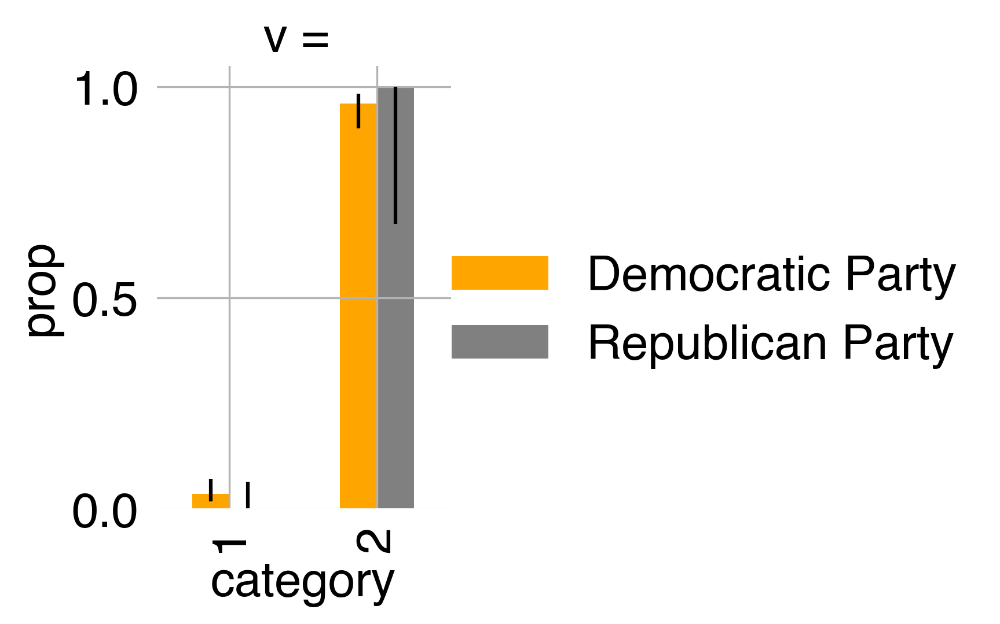

In [51]:
mask = (xVal['party_affiliation'] == 'Republican Party') | (xVal['party_affiliation'] == 'Democratic Party')

print_calibration_output(c, featVal[mask], yVal[mask], groups=xVal.loc[mask, 'party_affiliation'], bins=2)

  category      prop      mean        ll        ul  count
0        1  0.028689  0.029115  0.014724  0.029334  244.0
1        2  0.979798  0.943505  0.050488  0.014644   99.0


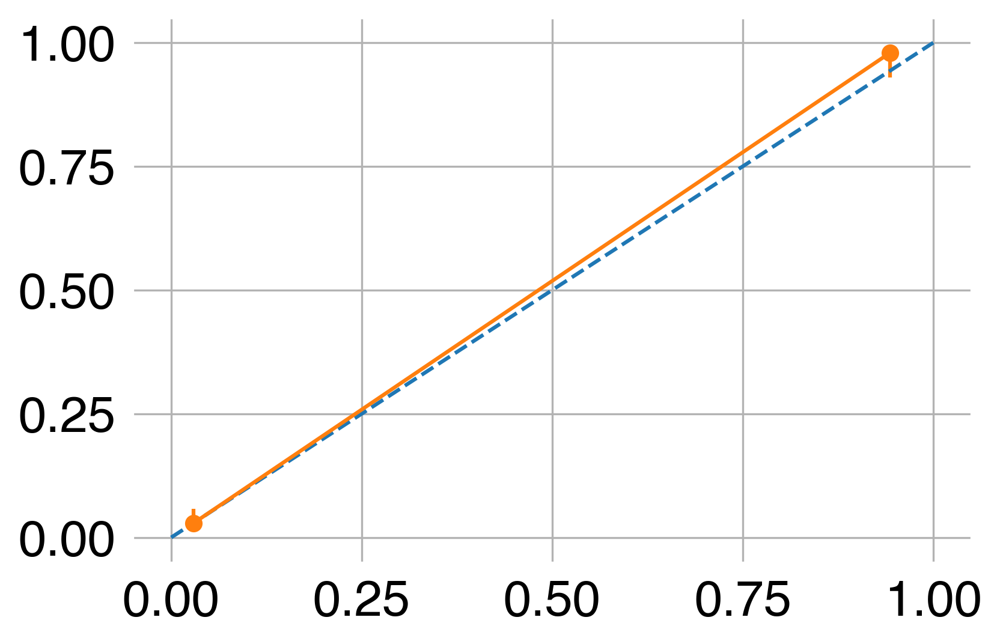

  category    group      prop      mean        ll        ul  count
0        1  Federal  0.031579  0.029805  0.017027  0.035593  190.0
1        1    State  0.018519  0.026691  0.015242  0.079196   54.0
2        2  Federal  0.977528  0.947239  0.055804  0.016288   89.0
3        2    State  1.000000  0.910272  0.277533  0.000000   10.0
Brier score loss: 0.01924761552102205


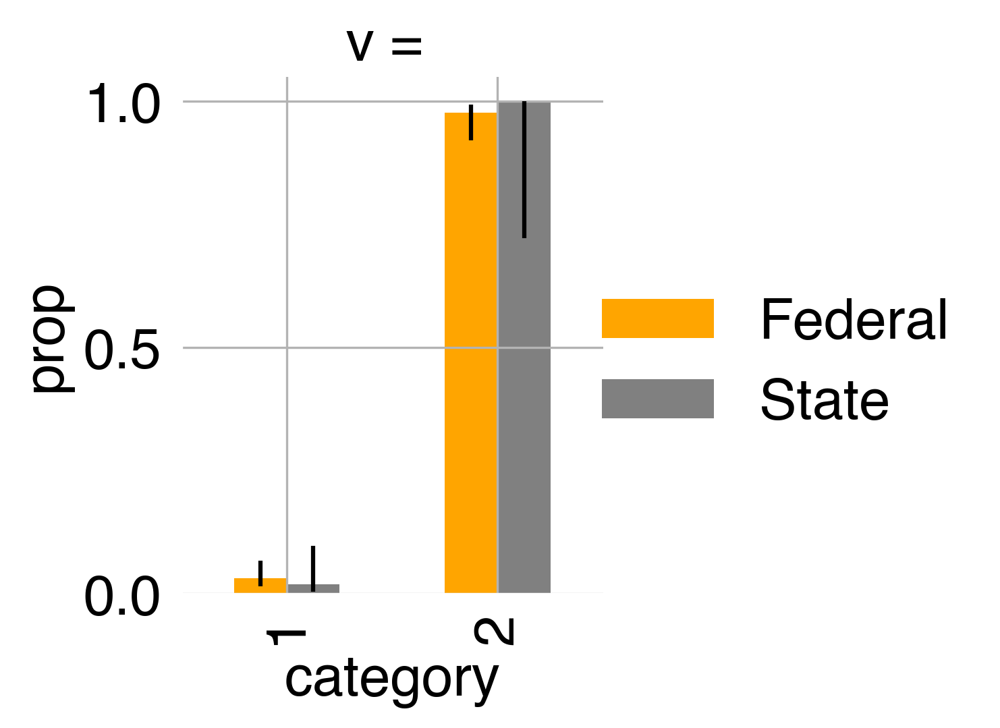

In [53]:
mask = (xVal['office_level'] == 'State') | (xVal['office_level'] == 'Federal')

print_calibration_output(c, featVal[mask], yVal[mask], groups=xVal.loc[mask, 'office_level'], bins=2)

  category      prop      mean        ll        ul  count
0        1  0.029661  0.028636  0.015220  0.030287  236.0
1        2  0.979592  0.943330  0.050974  0.014794   98.0


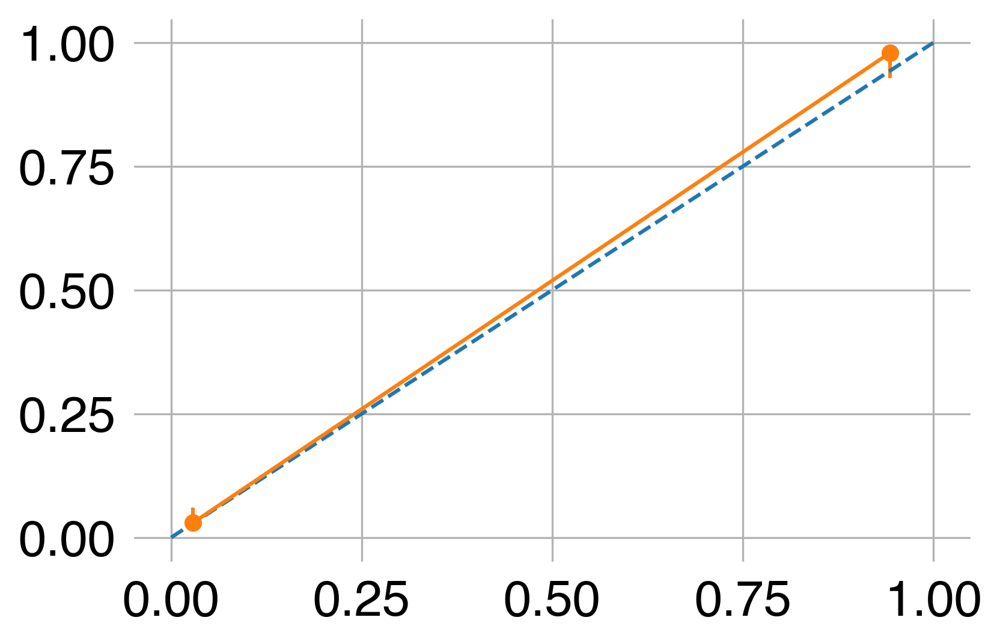

  category group      prop      mean        ll        ul  count
0        1    No  0.022599  0.022328  0.013776  0.034058  177.0
1        1   Yes  0.050847  0.047560  0.033405  0.088318   59.0
2        2    No  0.968254  0.936595  0.076819  0.022997   63.0
3        2   Yes  1.000000  0.955451  0.098901  0.000000   35.0
Brier score loss: 0.01955960208989297


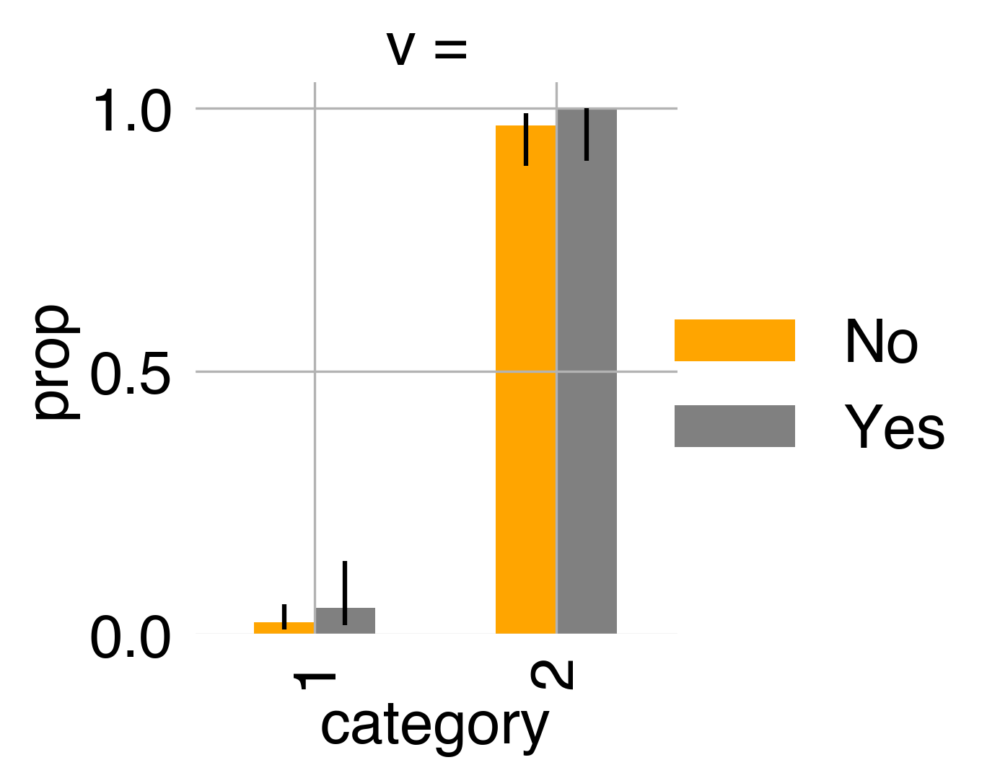

In [54]:
mask = (xVal['incumbent'] == 'Yes') | (xVal['incumbent'] == 'No')

print_calibration_output(c, featVal[mask], yVal[mask], groups=xVal.loc[mask, 'incumbent'], bins=2)

### Score the entire dataset

All the emails.

In [55]:
emails = pd.read_pickle('../data/emails_df.pkl')

In [56]:
res = c.predict_proba(clf.named_steps['feature_pipeline'].transform(emails).todense())[:,1]

In [57]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_' + label_column + '_score.pkl')

In [58]:
emails = None

All the A/B testing emails.

In [59]:
emails = pd.read_pickle('../data/emails_ab_df.pkl')

In [60]:
res = c.predict_proba(clf.named_steps['feature_pipeline'].transform(emails).todense())[:,1]

In [61]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_ab_' + label_column + '_score.pkl')

In [62]:
emails = None